In [2]:
import osmnx as ox
import random

import re
import matplotlib.colors as mcolors
import numpy as np

%matplotlib inline
import matplotlib.pyplot as plt
ox.__version__

'1.7.0'

图的节点数: 535
图的边数: 1624


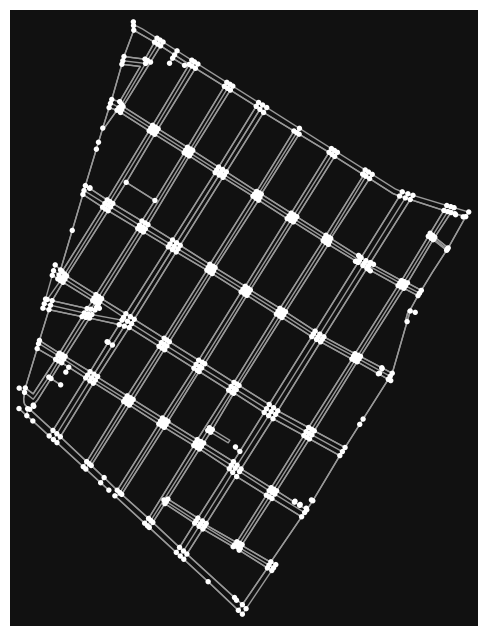

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [3]:
# 获取洛杉矶的OpenStreetMap数据
place = "SoHo, New York, NY"
#place = "Piedmont, California, USA"
#place = "Emeryville, California, USA"
#place = "Tianhe, GuangZhou, China"
#place = "The Chinese University of Hong Kong"
#place = "portland"
#place = [
#    "Piedmont, California, USA",
#    {"city": "Berkeley", "state": "California"},
#    "Emeryville, California, USA",
#]
graph = ox.graph_from_place(place, network_type='all')

# 打印图的基本信息
print("图的节点数:", len(graph.nodes))
print("图的边数:", len(graph.edges))

# 将图绘制出来以观察其结构
ox.plot_graph(ox.project_graph(graph))

In [4]:

# 获取不同类型的区域
tags = {
    'building': True,  # 获取所有建筑物
    'natural': True,
    'landuse': True,  # 获取所有草地和森林
    'highway': True,  # 获取所有道路
    'barrier': True,
    'water': True,
    'street':True,
    'ways':True
}
gdf = ox.features_from_place(place, tags)
print(gdf.columns)

Index(['highway', 'traffic_signals', 'geometry', 'crossing', 'kerb',
       'traffic_signals:direction', 'button_operated', 'tactile_paving',
       'traffic_signals:sound', 'traffic_signals:vibration',
       ...
       'sidewalk', 'fixme', 'maxspeed:conditional', 'layer', 'motor_vehicle',
       'tunnel', 'fence_type', 'cycleway:right:lane', 'ways', 'type'],
      dtype='object', length=168)


In [10]:
#print(gdf.head())
#print(gdf.info())
#for col in gdf.columns:
#    print(f'{col}:{gdf[col].unique()}')
#print(gdf['height'].unique())

<class 'geopandas.geodataframe.GeoDataFrame'>
MultiIndex: 1699 entries, ('node', 42428433) to ('relation', 14387194)
Columns: 170 entries, highway to color
dtypes: float64(1), geometry(1), object(168)
memory usage: 2.3+ MB


TypeError: a bytes-like object is required, not 'NoneType'

In [6]:
# 将高程统一
def convert_to_meters(height):
    if isinstance(height, str):
        if "foot" in height or "feet" in height:
            # 提取数字并转换为米
            number = float(re.findall(r'\d+\.?\d*', height)[0])
            return number * 0.3048
    if isinstance(height, (int, float)):
        # 假设其他数字默认为米
        return float(height)
    
    return float(0)

gdf['norm_h'] = [convert_to_meters(height) for height in gdf['height']]

In [7]:

building_categories = gdf['building'].unique()
color_mapping = {category: "#{:02x}{:02x}{:02x}".format(random.randint(100, 200), random.randint(100, 200), random.randint(100, 200)) for category in building_categories}
gdf['color']=gdf['building'].map(color_mapping)

gdf.loc[gdf['natural'].isin(['spring', 'water']), 'color'] = 'blue'
gdf.loc[gdf['natural'].isin(['sand', 'cliff']), 'color'] = 'yellow'
gdf.loc[gdf['natural'].isin(['tree', 'grassland','wood','shrubbery']), 'color'] = 'green'

gdf['color'] = gdf['color'].fillna('grey')

gdf['norm_h'] = (gdf['norm_h'] - gdf['norm_h'].min()) / (gdf['norm_h'].max() - gdf['norm_h'].min())
gdf['norm_h'] = gdf['norm_h'].fillna(0.)

def adjust_color(color, amount):
    rgb = mcolors.hex2color(color)
    # 将RGB颜色转换为HSV颜色
    hsv = mcolors.rgb_to_hsv(np.array(rgb).reshape(1, -1))
    if np.isscalar(hsv):
        hsv -= amount * 0.3
    else:
        hsv[0][2] -= amount * 0.3
    # 将HSV颜色转换回RGB颜色
    rgb = mcolors.hsv_to_rgb(hsv)
    return mcolors.rgb2hex(rgb[0])

gdf['color'] = gdf.apply(lambda row: adjust_color(row['color'], row['norm_h']), axis=1)
print(gdf['norm_h'],gdf['color'])

element_type  osmid   
node          42428433    0.0
              42428434    0.0
              42428436    0.0
              42428438    0.0
              42428441    0.0
                         ... 
relation      3340429     0.0
              3340490     0.0
              3340513     0.0
              7597658     0.0
              14387194    0.0
Name: norm_h, Length: 1699, dtype: float64 element_type  osmid   
node          42428433    #9e938c
              42428434    #9e938c
              42428436    #9e938c
              42428438    #9e938c
              42428441    #9e938c
                           ...   
relation      3340429     #786a8d
              3340490     #786a8d
              3340513     #786a8d
              7597658     #786a8d
              14387194    #9e938c
Name: color, Length: 1699, dtype: object


In [8]:
# 绘制地图
#fig, ax = ox.plot_graph(ox.project_graph(graph), bgcolor='white', node_color='k', node_size=5)
#ox.graph_from_place(place, network_type="drive", retain_all=True)
#fig, ax = ox.plot_footprints(gdf, figsize=(20, 20), bgcolor='white', color=gdf['color'])
ox.plot.plot_footprints(gdf, ax=None, figsize=(300, 300), color=gdf['color'], edge_color='black', edge_linewidth=1, alpha=None, bgcolor='white', bbox=None, save=False, show=True, close=False, filepath=None, dpi=600)
#gdf.plot(ax=ax, facecolor=gdf['color'], alpha=0.5)
#ox.plot_graph(ox.project_graph(graph), ax=ax, bgcolor='black', edge_color='gray', edge_linewidth=5)

(<Figure size 30000x30000 with 1 Axes>, <Axes: >)

In [9]:
# 保存一下要用到的图片
#fig.savefig('somepic/Oakland.png',facecolor='white')